# DAP Terminal Assessment

# Sumit Singh_X20135769_Group17

# Install essential libraries 

In [1]:
!pip install folium
!pip install requests
!pip install geopy
!pip install wordcloud
!pip install mysqlclient
!pip install mysql-connector-python
!pip install plotly_express
!pip install pymongo
!pip install datetime

# Function to import libraries

In [2]:
import folium
import requests
import numpy as np
import pandas as pd
import seaborn as sns
import mysql.connector
import plotly_express as px
from folium import plugins
from folium.plugins import HeatMap
from wordcloud import WordCloud 
from datetime import date, timedelta
from pymongo import MongoClient
from matplotlib import pyplot as plt
from datetime import date, timedelta
from geopy.exc import GeocoderTimedOut
from geopy.geocoders import Nominatim

# Function to fetch data from the NYC Open Data API

In [3]:
def FetchDataFromAPI():
    appenddf=pd.DataFrame()
    startDate = date(2011, 1, 3)
    endDate = date(2019, 1, 31)
    deltaCounter = timedelta(days=7)
    while startDate <= endDate:
        nextDate = str((startDate + deltaCounter).strftime("%Y-%m-%dT12:00:00"))
        url = "https://data.cityofnewyork.us/resource/8h9b-rp9u.json?$where=arrest_date between "+ "'" +startDate.strftime("%Y-%m-%dT12:00:00")+ "'" + " and " + "'" +nextDate + "'" +"&$limit=20&$$app_token=2kB9Aynx6jVhYuRTPmsPLChlC"
        response = requests.get(url)
        dftest = pd.DataFrame(response.json())
        appenddf=appenddf.append(dftest,ignore_index=True)
        startDate += deltaCounter
    return appenddf

# Function to create a connection with MongoDB while creating Database and Records

In [4]:
def CreateMongoDBDatabase(appenddf):
    myclient = MongoClient('127.0.0.1', 27017)
    mydb = myclient["group17_nypd"]
    collection_arrests = mydb['Arrests']

    data = appenddf.to_dict(orient='records')
    collection_arrests.insert_many(data)

    myclient.close()
    return mydb

# Function to fetch data from MongoDB and store it in a Dataframe

In [5]:
def FetchDataFromMongoDB(mydb):
    dffinal = pd.DataFrame()
    fetchFromMongo = pd.DataFrame(mydb.Arrests.find())
    return fetchFromMongo

# Function for data Cleaning and pre-processing

In [6]:
def DatasetCleaningAndPreprocessing(fetchFromMongo):
    dffinal = fetchFromMongo.drop(["_id","pd_cd","lon_lat"],axis = 1)
    dffinal = dffinal.dropna()
    dffinal.drop_duplicates()
    indexNames = dffinal[dffinal['perp_race'] == "UNKNOWN" ].index
    dffinal.drop(indexNames , inplace=True)
    return dffinal

# Visualizations

# ---------------------------------------------------------------------------------------------------------------

# Function to create a map to highlight the location of all the arrests made in New York City

In [7]:
def CreateMapForArrests(dffinal):
    geolocator = Nominatim(user_agent="DAP_Project_Test_Agent")
    newYorkCoordinates = geolocator.geocode("NYC")

    dfFromSQL_Map = folium.Map(location=[newYorkCoordinates.latitude,newYorkCoordinates.longitude],tiles='OpenStreetMap',
     zoom_start=10)
    for val in dffinal[:6000].iterrows():
        folium.CircleMarker([val[1]['latitude'],val[1]['longitude']],
                            radius=1,
                            color='blue',
                            popup=str(val[1]['latitude'])+','+str(val[1]['longitude']),
                            fill_color='#FD8A6C'
                            ).add_to(dfFromSQL_Map)
    return dfFromSQL_Map

# Function to create a word map for major offences for which arrests were made by the NYPD

In [8]:
def PlotWordMapOffences(dffinal):
    textdf = pd.DataFrame(dffinal['ofns_desc'].apply(str))
    textdf['ofns_desc'] = textdf['ofns_desc'].str.replace('& RELATED OFFENSES',' ')

    wordcloud = WordCloud(max_font_size=50, max_words=100, background_color="white").generate(' '.join(textdf['ofns_desc']))

    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

# Function to plot a histogram for number of arrests that happened on a yearly basis

In [9]:
def PlotArrestsByYear(dffinal):  
    fig = px.histogram(dffinal['arrest_date'],
                       opacity = 0.5)
    fig.update_layout(title="Arrests in New York Over the time period 2011-2019",
    xaxis_title="Year",
    yaxis_title="Number of Arrests",
    showlegend=False)
    fig.show()

# Function to plot a Animation for number of arrests that happened on a yearly basis

In [10]:
def PlotArrestsByYearAnimation(dffinal):
    topTenOffences = dffinal['ofns_desc'].value_counts()[:10].index.tolist()
    dfTopOffences = dffinal.loc[dffinal["ofns_desc"].isin(topTenOffences)]
    dfTopOffences['year'] = pd.to_datetime(dfTopOffences['arrest_date']).dt.year
    
    fig = px.histogram(dfTopOffences, y='ofns_desc', animation_frame="year", color='ofns_desc',
                   title='Arrests in New York over the time period 2011-2019 based on offence description')
    fig.update_layout(
        xaxis_title="Number of offences",
        yaxis_title="Offence Description")
    fig.show()

# Function to plot number of arrests made based on the age group of the perpetuator

In [11]:
def PlotAgeGroupByOffense(dffinal):
    a = pd.DataFrame(dffinal.groupby("age_group").ofns_desc.agg(lambda x:len(x.unique())))

    a.plot(kind="line", title="Number of Arrests in the New York Region based on Age Group",
       xlabel="The arrest made across different age groups",
       ylabel="Number of Arrests",
       color="green",
       legend=False)

# Function to plot number of arrests made in each borough of the New York City

In [12]:
def PlotBoroughByOffense(dffinal):
    DFReplace_Abbreviations_with_BoroughNames = dffinal
    DFReplace_Abbreviations_with_BoroughNames['arrest_boro'].replace(to_replace =["B","M","K","S","Q"],value =["BRONX","MANHATTAN","BROOKLYN","STATEN ISLAND","QUEENS"],inplace=True)
    #Borough of arrest. B(Bronx), S(Staten Island), K(Brooklyn), M(Manhattan), Q(Queens)
    b = pd.DataFrame(DFReplace_Abbreviations_with_BoroughNames.groupby("arrest_boro").ofns_desc.agg(lambda x:len(x.unique())))
    b.plot(kind="area", title="Number of Arrests based on different New York Boroughs",
           xlabel="Borough",
           ylabel="Number of Arrests",
           color="orange",
           legend=False)

# Function to plot number of arrests made based on the gender of the perpetuator

In [13]:
def PlotGenderByOffense(dffinal):
    c = pd.DataFrame(dffinal.groupby("perp_sex").ofns_desc.agg(lambda x:len(x.unique())))

    c.plot(kind="barh", title="Number of Arrests in the New York Region based on Gender of the Perpetuator",
       xlabel="Gender",
       ylabel="Number of Arrests",
       color="purple",
       legend=False)

# Function to plot number of arrests made based on the age group of the perpetuator

In [14]:
def PlotAgeGroupByOffenseLeadingOffences(dffinal):
    topTenOffences = dffinal['ofns_desc'].value_counts()[:10].index.tolist()
    dfTopOffences = dffinal.loc[dffinal["ofns_desc"].isin(topTenOffences)]
    
    fig = px.bar(dfTopOffences, y='ofns_desc', x='age_group',color='ofns_desc',opacity=1.0,
                title="The arrests made on basis of age group with different ethnic groups")
    fig.update_layout(width=1100, height=550, bargap=0.1,
                  xaxis_title="Age Group",
                  yaxis_title="Number of Arrests")
    fig.show()

# Function to plot number of arrests made based on the ethnic race of the perpetuator

In [15]:
def PlotRaceByOffense(dffinal):
    fig = px.bar(dffinal, y='ofns_desc', x='perp_race',
                title="The arrests made on basis of different ethnic groups")
    fig.update_traces(marker_color='red')
    fig.update_layout(width=900, height=550, bargap=0.1,xaxis_title="Ethnic Group",yaxis_title="Number of Arrests")
    fig.show()

# Function to plot types of offences made based on the ethnic race of the perpetuator

In [16]:
def PlotRaceByOffenseLeadingOffences(dffinal):
    topTenOffences = dffinal['ofns_desc'].value_counts()[:10].index.tolist()
    dfTopOffences = dffinal.loc[dffinal["ofns_desc"].isin(topTenOffences)]
    
    fig = px.funnel(dfTopOffences, y='ofns_desc', x='perp_race', color='ofns_desc',
                title="The arrests made on basis of different ethnic groups in respect to the offences commited")
    fig.update_layout(width=1100, 
                      height=650, 
                      bargap=0.1,
                      xaxis_title="Ethnic Group",
                      yaxis_title="Number of Arrests")
    fig.show()

# Function to plot offences occuring per year

In [17]:
def PlotOffenseByYear(dffinal):
    fig = px.scatter(dffinal, x='ofns_desc', y='arrest_date'
    , title="The arrests made on basis of different ethnic groups over the period of time")
    fig.update_layout(
        xaxis_title="Offence Description",
        yaxis_title="Year")
    fig.show()

# Function to check the age group of the arrestees in a borough

In [18]:
def PlotAgeGroupToBoroughAnimated(dffinal):
    topTenOffences = dffinal['ofns_desc'].value_counts()[:10].index.tolist()
    dfTopOffences = dffinal.loc[dffinal["ofns_desc"].isin(topTenOffences)]
    dfTopOffences['year'] = pd.to_datetime(dfTopOffences['arrest_date']).dt.year
    
    fig = px.histogram(dfTopOffences, 
                       x="age_group",
                       color="arrest_boro",
                       animation_frame="year",
                       title="Age Group of arrestees in a Borough")
    fig.update_layout(
        xaxis_title="Age Group",
        yaxis_title="Number of Arrests")
    fig.show()

# Function to check the Number of Males and Females arrested in a borough

In [19]:
def PlotAgeGroupToPerpSexAnimated(dffinal):
    topTenOffences = dffinal['ofns_desc'].value_counts()[:10].index.tolist()
    dfTopOffences = dffinal.loc[dffinal["ofns_desc"].isin(topTenOffences)]
    dfTopOffences['year'] = pd.to_datetime(dfTopOffences['arrest_date']).dt.year
    
    fig = px.histogram(dfTopOffences, 
                        x="age_group",
                        color="perp_sex",animation_frame="year",
                        title="Gender of arrestees based on their age")
    fig.update_layout(
        xaxis_title="Age Group",
        yaxis_title="Number of Arrests")
    fig.show()

# MySQL

# Function to create a connection with MySQL using the connector function

In [20]:
def CreateDatabaseInMySQL():
    db = mysql.connector.connect(user='dap', password='root',
                              host='127.0.0.1')
    mycursor = db.cursor(buffered=True)
    mycursor.execute("CREATE DATABASE IF NOT EXISTS group17_nypd")
    db.close()
    mycursor.close()

# Function to create the Database in MySQL

In [21]:
def ConsumeMySQLConnection():
    db = mysql.connector.connect(user='dap', password='root',
                              host='127.0.0.1', database='group17_nypd')
    mycursor = db.cursor(buffered=True)
    return db, mycursor

# Function to create tables for shootings, arrests and summons

In [22]:
def CreateTableInMySQL(mycursor):
    mycursor.execute("""CREATE TABLE IF NOT EXISTS NYPD_Arrests_Data_Historic_Sumit_20135769(
                 arrest_key VARCHAR(255), 
                 arrest_date VARCHAR(255), 
                 pd_desc VARCHAR(255), 
                 ky_cd VARCHAR(50), 
                 ofns_desc VARCHAR(255), 
                 law_code VARCHAR(50), 
                 law_cat_cd VARCHAR(25), 
                 arrest_boro VARCHAR(25), 
                 arrest_precinct VARCHAR(50), 
                 jurisdiction_code VARCHAR(25), 
                 age_group VARCHAR(50), 
                 perp_sex VARCHAR(25), 
                 perp_race VARCHAR(50), 
                 x_coord_cd VARCHAR(255), 
                 y_coord_cd VARCHAR(255), 
                 latitude VARCHAR(255), 
                 longitude VARCHAR(255))""")

# Insert Values from Dataframe in the Arrests Database

In [23]:
def InsertValuesInArrestTable(dffinal, mycursor, db):
    cols = "`,`".join([str(i) for i in dffinal.columns.tolist()])
    for i,row in dffinal.iterrows():
        sql = "INSERT INTO `NYPD_Arrests_Data_Historic_Sumit_20135769` (`" +cols + "`) VALUES (" + "%s,"*(len(row)-1) + "%s)" 
        mycursor.execute(sql, tuple(row)) 
        db.commit()

# Fetch Data from MySQL for the Arrests made by NYPD from 2011-2019

In [24]:
def FetchDataFromMySQL_Arrests():
    mycursor.execute("SELECT * FROM NYPD_Arrests_Data_Historic_Sumit_20135769")
    rows = mycursor.fetchall()

    dfFromSQL = pd.DataFrame(rows, columns=mycursor.column_names)
    dfFromSQL

# Function to execute the complete file

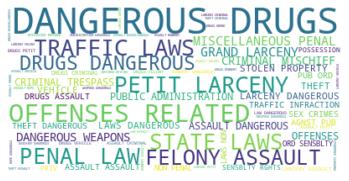

<ipython-input-10-34e9bf16553e>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



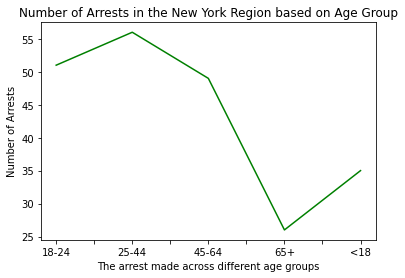

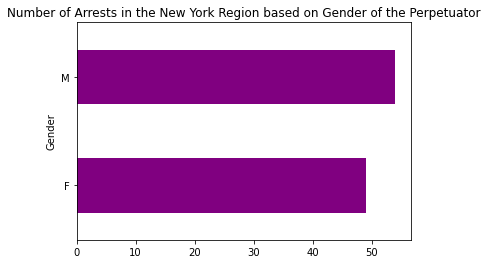

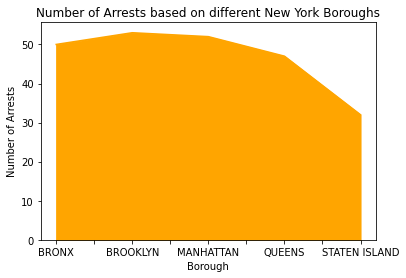

In [25]:
def ExecuteFile():
    
    #Fetch Data Request from the API
    DfFromAPI = FetchDataFromAPI()
    
    #Create a connection to MongoDB database
    dbConnectionMongo = CreateMongoDBDatabase(DfFromAPI)
    
    #Fetch Data From MongoDB
    dfFromMongo = FetchDataFromMongoDB(dbConnectionMongo)
    
    #Data Cleaning and Preprocessing
    dfFinal = DatasetCleaningAndPreprocessing(dfFromMongo)
    
    #Create a map for all the location for arrests in the New York city areas
    dfMapOutput = CreateMapForArrests(dfFinal)
    
    #Plot visualizations based on the offence descriptions
    PlotWordMapOffences(dfFinal)
    PlotAgeGroupByOffense(dfFinal)
    PlotGenderByOffense(dfFinal)
    PlotBoroughByOffense(dfFinal)
    
    #Plot visualizations based on the Year of the arrests
    PlotArrestsByYear(dfFinal)
    PlotArrestsByYearAnimation(dfFinal)
    PlotOffenseByYear(dfFinal)
    
    #Plot visualizations based on race and offences of the arrestees 
    PlotRaceByOffense(dfFinal)
    PlotAgeGroupByOffenseLeadingOffences(dfFinal)
    PlotRaceByOffenseLeadingOffences(dfFinal)
    
    #Plot age group based on Borugh and gender
    PlotAgeGroupToBoroughAnimated(dfFinal)
    PlotAgeGroupToPerpSexAnimated(dfFinal)
    
    #Create a connection and database in MySQL database
    CreateDatabaseInMySQL()
    dbConMySQL, MyCursor = ConsumeMySQLConnection()
    #Create a table in MySQL database
    CreateTableInMySQL(MyCursor)
    #Inser the processed values in the table in MySQL database
    InsertValuesInArrestTable(dfFinal,MyCursor,dbConMySQL)
    return dfMapOutput

#Execute the main function and display all the maps, graphs and plots
finalOutput = ExecuteFile()
finalOutput